In [1]:
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time

Importing libraries


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice')
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')
        plt.title(f'Reconstructed {title} Slice')
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function = SSIMLoss(spatial_dims=3)
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)

    def training_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Slice 1')
            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Slice 2')
            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Slice 3')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Slice 1')
            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Slice 2')
            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Slice 3')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars('AE SSIM Job 2 Loss', {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='AE_SSIM{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc, transform=transform, num_workers=0)
val_dataset   = CacheDataset(val_dataset_uc,   transform=transform, num_workers=0)

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True,  num_workers=2)
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False, num_workers=2)

trainer = pl.Trainer(
    max_epochs=1500,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)


Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]


Loading dataset:   6%|▌         | 1/18 [00:03<01:03,  3.75s/it]


Loading dataset:  11%|█         | 2/18 [00:09<01:16,  4.77s/it]


Loading dataset:  17%|█▋        | 3/18 [00:13<01:04,  4.31s/it]


Loading dataset:  22%|██▏       | 4/18 [00:16<00:58,  4.15s/it]


Loading dataset:  28%|██▊       | 5/18 [00:21<00:55,  4.31s/it]


Loading dataset:  33%|███▎      | 6/18 [00:25<00:52,  4.37s/it]


Loading dataset:  39%|███▉      | 7/18 [00:29<00:45,  4.13s/it]


Loading dataset:  44%|████▍     | 8/18 [00:34<00:43,  4.40s/it]


Loading dataset:  50%|█████     | 9/18 [00:39<00:40,  4.45s/it]


Loading dataset:  56%|█████▌    | 10/18 [00:42<00:33,  4.19s/it]


Loading dataset:  61%|██████    | 11/18 [00:45<00:27,  3.88s/it]


Loading dataset:  67%|██████▋   | 12/18 [00:53<00:29,  4.86s/it]


Loading dataset:  72%|███████▏  | 13/18 [00:56<00:22,  4.53s/it]


Loading dataset:  78%|███████▊  | 14/18 [01:00<00:17,  4.33s/it]


Loading dataset:  83%|████████▎ | 15/18 [01:06<00:14,  4.73s/it]


Loading dataset:  89%|████████▉ | 16/18 [01:11<00:09,  4.77s/it]


Loading dataset:  94%|█████████▍| 17/18 [01:20<00:06,  6.02s/it]


Loading dataset: 100%|██████████| 18/18 [01:26<00:00,  6.08s/it]


Loading dataset: 100%|██████████| 18/18 [01:26<00:00,  4.80s/it]


Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]


Loading dataset:  12%|█▎        | 1/8 [00:07<00:52,  7.52s/it]


Loading dataset:  25%|██▌       | 2/8 [00:25<01:22, 13.72s/it]


Loading dataset:  38%|███▊      | 3/8 [00:34<00:56, 11.31s/it]


Loading dataset:  50%|█████     | 4/8 [00:49<00:51, 12.78s/it]


Loading dataset:  62%|██████▎   | 5/8 [00:56<00:32, 10.96s/it]


Loading dataset:  75%|███████▌  | 6/8 [01:06<00:21, 10.67s/it]


Loading dataset:  88%|████████▊ | 7/8 [01:16<00:10, 10.33s/it]


Loading dataset: 100%|██████████| 8/8 [01:25<00:00,  9.83s/it]


Loading dataset: 100%|██████████| 8/8 [01:25<00:00, 10.66s/it]

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /old_Users/tgafrick/RA4/jobs/job6/Models exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | SSIMLoss    | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

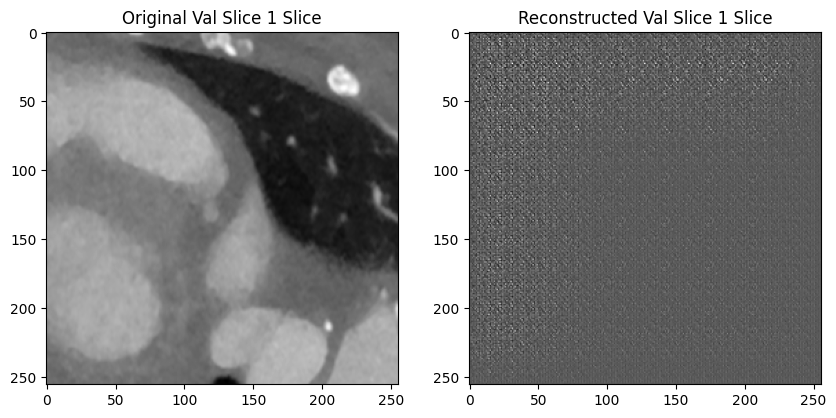

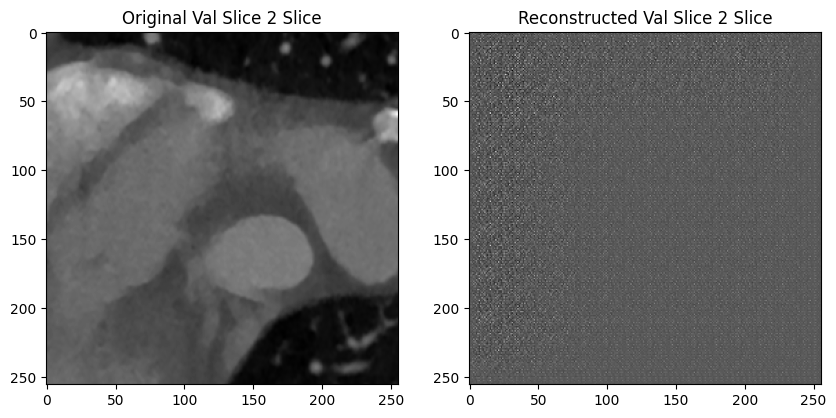

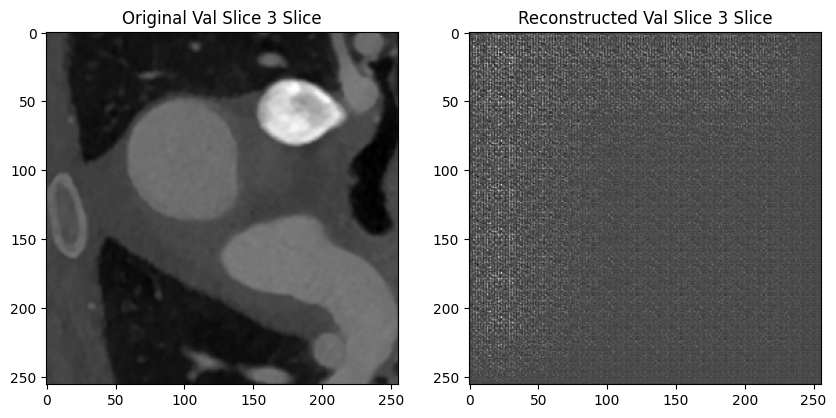

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

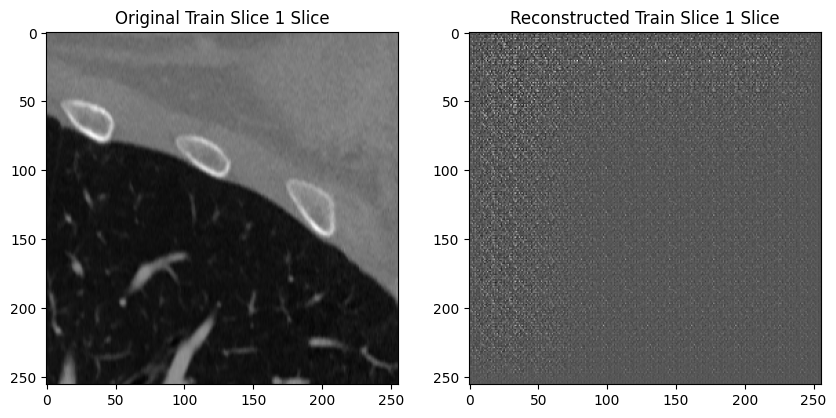

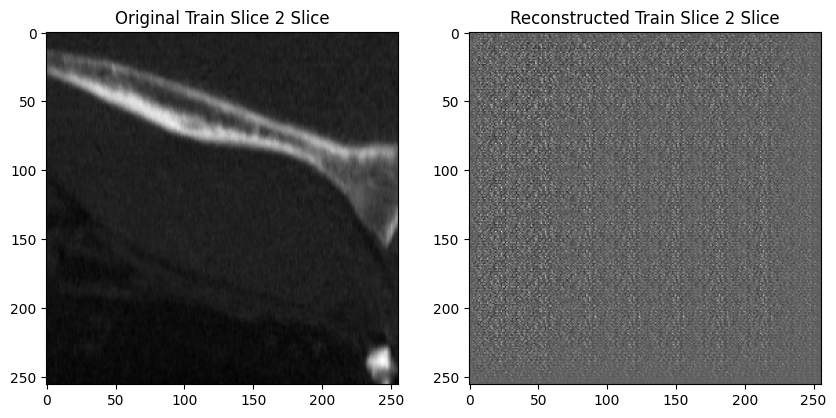

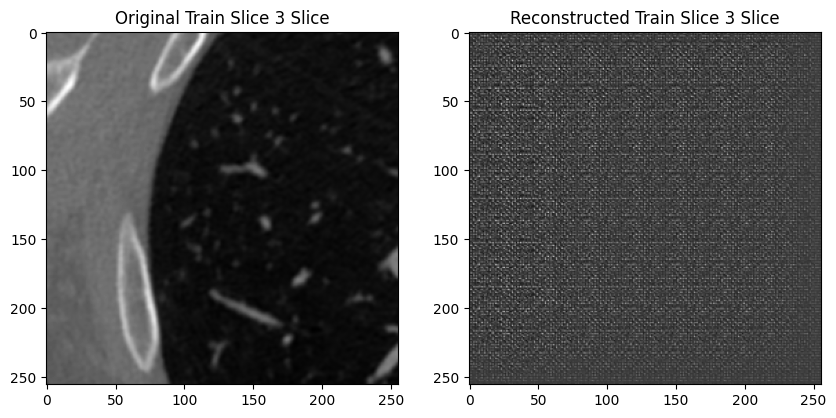

Validation: |          | 0/? [00:00<?, ?it/s]

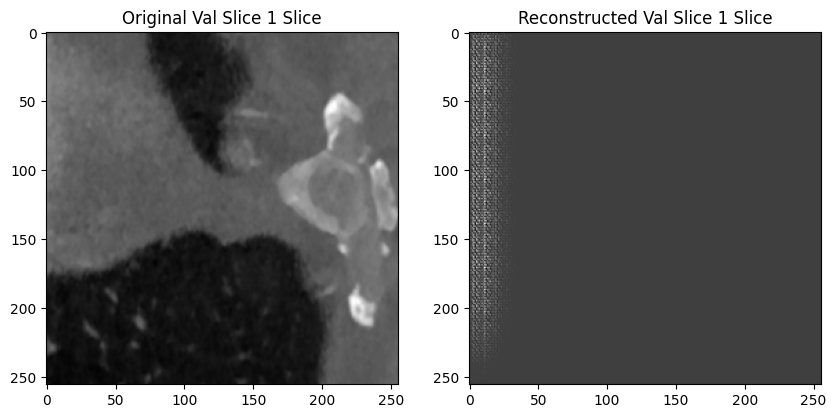

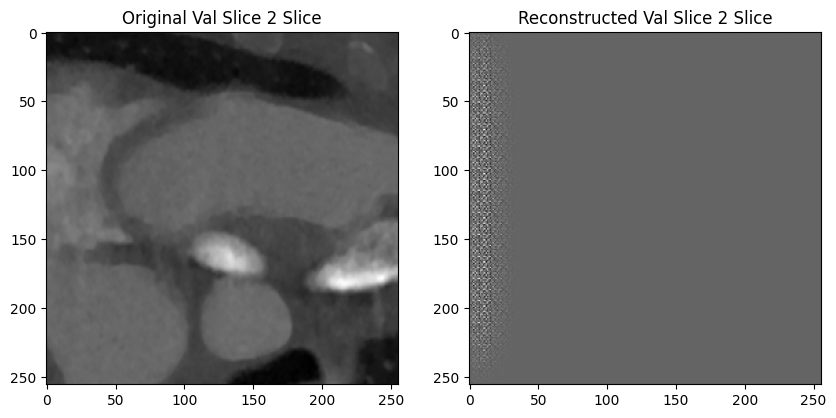

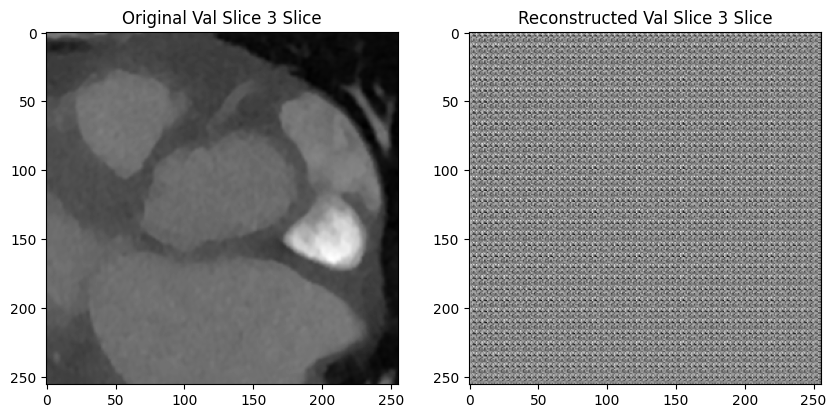

Time Spent 309.07
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 430.29
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 551.58
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 673.23
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 794.77
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 916.29
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1037.59
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1159.22
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1281.10
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1402.99
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1524.20
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1645.40
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1766.67
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1887.88
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2009.15
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2130.38
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2251.52
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2372.85
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2494.06
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2615.23
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2736.42
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2857.80
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2979.00
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3100.23
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3222.37
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3343.68
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3464.91
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3586.19
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3707.48
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3828.91
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3951.57
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4072.98
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4194.44
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4315.66
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4436.98
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4558.22
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4679.45
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4800.96
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4922.15
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5043.41
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5164.65
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5285.79
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5407.25
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5528.65
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5649.89
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5771.36
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5892.88
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6014.22
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6135.40
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6257.41
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6378.93
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6500.16
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6621.43
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6742.82
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6864.02
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6985.41
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7106.69
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7227.89
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7349.02
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7470.25
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7591.41
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7712.58
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7833.78
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7955.02
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8076.95
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8198.54
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8320.01
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8441.23
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8562.58
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8683.99
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8806.68
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8927.98
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9049.41
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9170.70
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9292.94
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9414.52
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9535.99
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9657.31
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9778.52
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9899.86
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10021.36
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10142.49
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10264.29
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10385.74
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10507.19
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10628.57
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10749.91
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10871.24
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10992.45
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11113.62
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11234.84
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11356.10
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11477.24
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11598.42
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11719.58
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11840.92
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11962.14
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12083.41
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12204.67
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12326.56
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12447.84
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12569.10
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12690.27
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12811.43
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12932.62
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13053.79
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13174.93
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13296.30
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13417.56
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13538.76
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13660.13
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13781.51
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13902.86
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14024.32
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14145.68
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14266.97
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14388.23
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14509.68
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14631.02
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14752.32
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14873.65
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14994.92
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15116.24
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15237.55
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15359.81
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15481.16
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15602.60
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15724.05
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15845.42
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15966.75
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16090.16
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16212.46
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16333.86
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16455.15
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16576.61
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16697.88
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16819.24
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16940.64
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17061.94
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17183.30
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17304.58
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17425.80
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17547.15
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17668.49
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17789.88
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17911.50
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18032.93
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18154.20
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18275.44
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18397.77
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18519.10
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18640.45
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18761.81
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18883.19
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19004.53
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19125.85
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19247.51
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19369.34
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19491.46
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19612.99
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19734.55
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19856.09
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19977.47
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20099.09
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20220.38
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20341.78
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20463.06
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20584.51
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20705.90
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20827.26
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 20948.50
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21069.95
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21191.35
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21312.85
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21434.84
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21556.09
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21677.53
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21798.75
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 21919.94
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22041.29
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22162.50
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22283.65
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22404.91
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22526.40
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22647.80
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22769.14
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 22891.16
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23012.67
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23133.98
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23255.40
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23376.82
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23498.24
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23619.52
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23740.90
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23862.19
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 23983.60
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24104.95
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24226.30
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24347.61
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24469.77
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24592.30
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24713.59
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24834.88
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 24956.24
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25077.55
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25198.91
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25320.35
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25441.71
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25563.25
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25684.66
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25806.06
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 25927.61
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26049.06
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26170.55
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26291.91
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26413.19
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26534.58
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26655.93
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26777.35
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 26898.83
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27020.26
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27141.88
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27263.19
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27384.66
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27506.64
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27628.00
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27749.39
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27870.68
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 27992.32
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28113.71
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28234.97
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28356.20
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28477.58
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28599.25
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28720.54
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28842.04
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 28964.81
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29086.23
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29207.53
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29328.90
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29450.28
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29572.01
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29693.33
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29814.90
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 29936.15
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30057.51
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30178.79
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30300.15
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30421.37
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30543.43
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30664.92
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30786.29
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 30907.62
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31029.09
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31150.29
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31271.56
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31392.76
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31514.05
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31635.36
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31756.56
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31877.78
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 31999.03
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32120.24
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32241.72
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32362.98
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32484.34
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32605.93
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32727.42
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32849.19
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 32970.46
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33091.87
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33213.18
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33334.50
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33455.83
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33577.91
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33699.15
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33820.59
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 33941.92
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34063.13
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34184.41
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34305.89
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34427.18
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34548.46
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34669.75
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34791.04
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 34912.22
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35033.65
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35155.20
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35276.45
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35397.93
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35519.25
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35640.59
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35761.77
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 35883.20
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36004.61
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36126.06
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36247.50
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36368.87
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36490.22
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36612.23
Epoch: 300


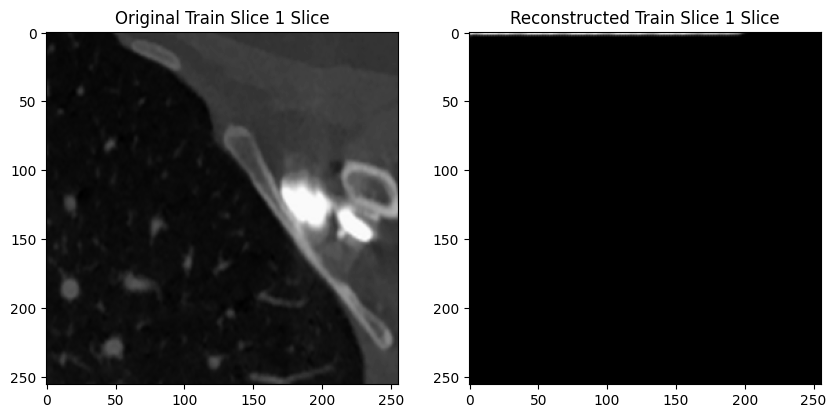

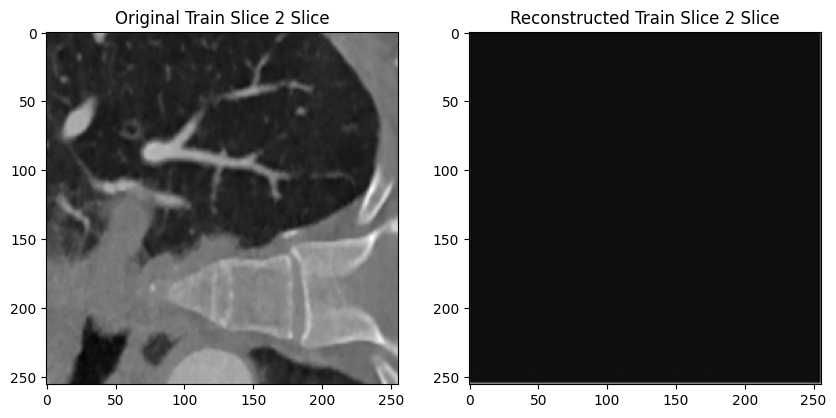

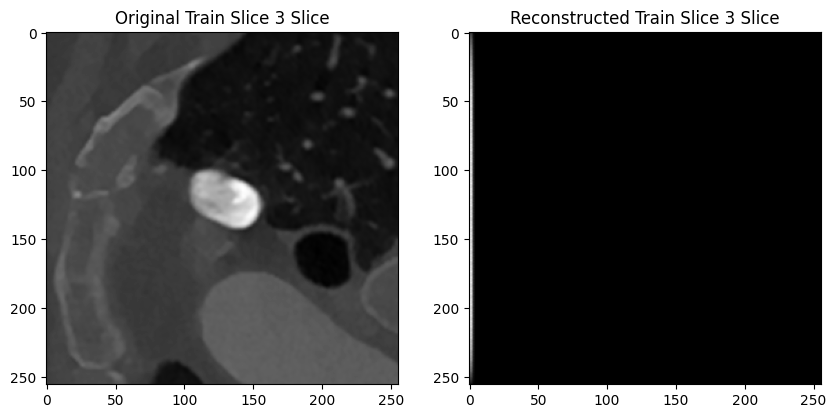

Validation: |          | 0/? [00:00<?, ?it/s]

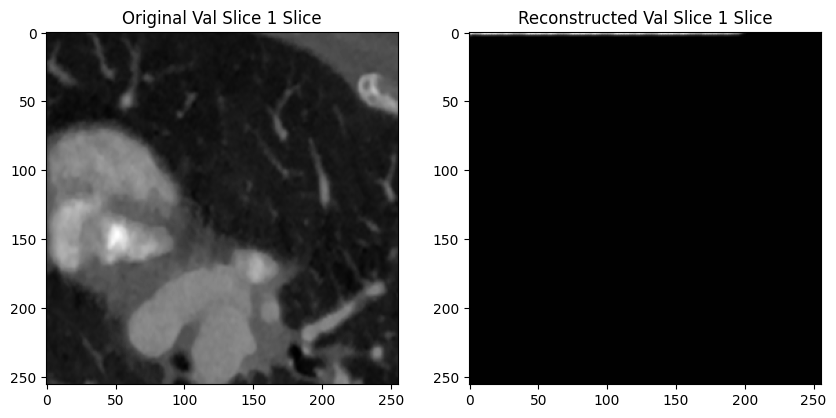

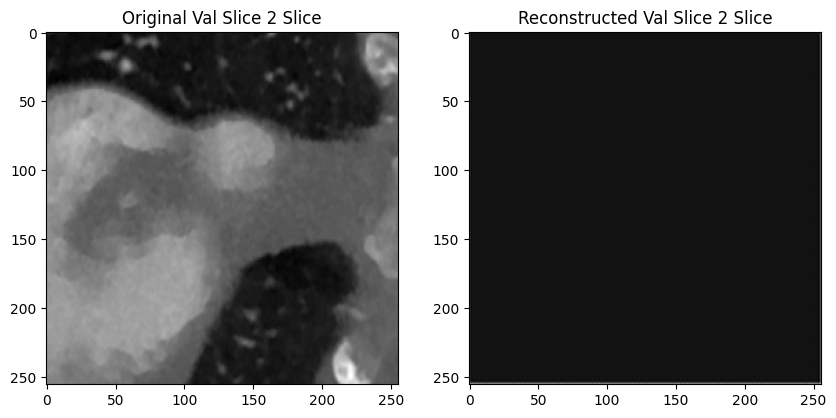

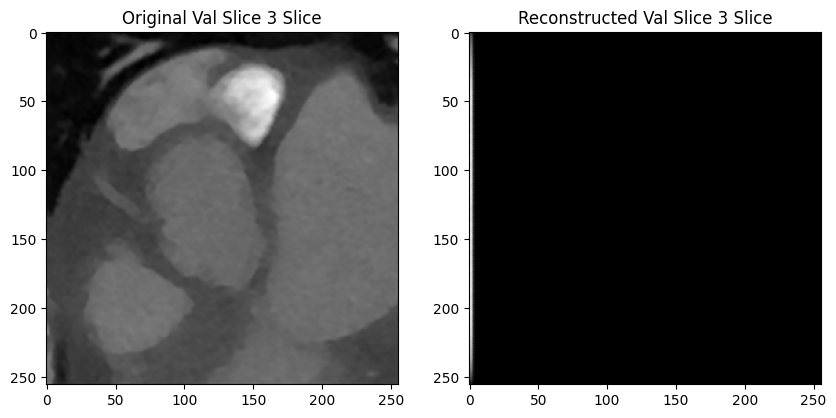

Time Spent 36735.89
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36857.42
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 36978.78
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37100.24
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37221.66
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37343.19
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37464.53
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37585.86
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37707.17
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37828.54
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 37950.14
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38071.53
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38192.90
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38314.39
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38435.77
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38557.18
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38678.75
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38800.17
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 38921.42
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39042.77
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39164.18
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39285.51
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39407.06
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39528.46
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39650.60
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39772.02
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 39893.22
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40014.65
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40136.01
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40257.46
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40378.80
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40500.19
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40621.62
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40742.85
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40864.23
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 40985.61
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41107.16
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41228.75
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41350.15
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41471.56
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41592.98
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41714.39
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41835.87
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 41957.18
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42078.62
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42200.00
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42321.40
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42442.94
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42564.31
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42686.47
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42807.87
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 42929.22
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43050.52
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43171.88
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43293.34
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43414.81
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43536.25
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43657.62
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43779.17
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 43900.61
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44021.93
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44143.46
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44264.76
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44386.08
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44507.29
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44628.50
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44749.77
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44871.16
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 44992.38
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45113.75
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45235.07
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45356.33
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45477.48
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45598.75
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45720.96
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45842.43
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 45963.77
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46085.05
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46206.42
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46327.76
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46449.25
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46570.59
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46691.81
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46813.02
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 46934.20
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47055.56
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47176.82
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47298.07
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47419.49
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47540.78
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47662.27
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47783.73
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 47904.97
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48026.30
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48147.66
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48269.15
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48390.68
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48511.86
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48633.10
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48755.02
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48877.24
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 48998.50
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49119.81
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49241.00
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49362.18
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49483.56
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49604.80
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49726.02
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49847.35
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 49968.78
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50089.98
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50211.22
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50332.55
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50453.84
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50575.12
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50696.38
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50817.65
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 50938.88
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51060.09
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51181.35
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51302.56
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51423.84
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51545.15
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51666.52
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51788.57
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 51909.87
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52031.11
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52152.37
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52273.66
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52394.90
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52516.40
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52637.68
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52758.86
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 52880.14
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53001.64
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53122.88
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53244.33
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53365.53
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53486.75
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53608.06
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53729.30
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53850.69
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 53972.09
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54093.38
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54214.71
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54335.95
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54457.23
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54578.48
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54699.70
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54821.73
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 54943.01
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55064.43
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55185.69
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55306.93
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55428.17
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55549.63
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55670.92
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55792.19
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 55913.46
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56034.73
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56156.67
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56277.93
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56399.18
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56520.44
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56641.69
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56763.03
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 56884.22
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57005.36
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57126.71
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57247.99
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57369.35
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57490.66
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57611.97
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57733.24
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57855.27
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 57976.69
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58098.13
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58219.57
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58340.93
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58462.34
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58584.15
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58705.63
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58827.17
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 58948.59
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59069.88
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59191.10
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59312.51
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59433.82
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59555.09
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59676.31
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59797.64
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 59918.87
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60040.13
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60161.33
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60282.60
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60403.89
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60525.07
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60646.50
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60767.81
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 60889.94
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61011.34
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61132.65
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61253.85
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61375.07
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61496.35
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61617.77
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61739.14
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61860.48
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 61981.88
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62103.34
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62224.82
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62346.25
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62467.69
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62589.14
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62710.68
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62832.18
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 62953.50
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63074.92
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63196.42
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63317.90
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63439.17
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63560.51
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63681.88
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63803.30
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 63925.54
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64046.72
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64167.91
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64289.19
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64410.45
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64531.67
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64652.94
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64774.18
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 64895.51
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65016.80
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65138.04
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65259.32
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65380.68
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65502.03
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65623.40
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65744.67
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65866.02
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 65987.33
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66108.63
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66229.96
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66351.25
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66472.49
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66593.79
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66715.05
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66836.26
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 66958.28
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67079.55
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67200.78
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67322.04
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67443.43
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67564.80
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67686.03
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67807.39
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 67928.87
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68050.13
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68171.93
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68293.44
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68414.74
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68535.96
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68657.22
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68778.55
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 68899.75
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69020.98
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69142.22
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69263.64
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69385.02
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69506.29
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69627.70
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69749.02
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69870.21
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 69992.33
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70113.57
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70235.09
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70356.71
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70478.27
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70601.05
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70722.43
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70843.81
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 70965.37
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71087.10
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71208.51
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71329.83
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71451.34
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71575.83
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71701.30
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71828.14
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 71949.43
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72070.87
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72192.37
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72313.88
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72435.98
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72557.32
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72679.32
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72801.13
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 72922.67
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73044.93
Epoch: 600


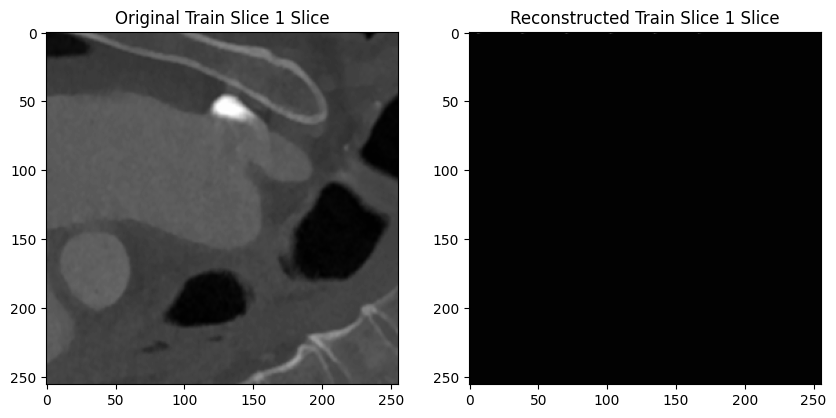

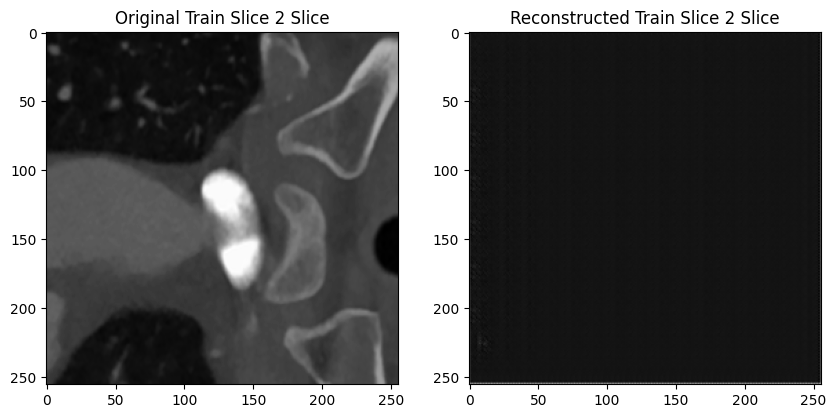

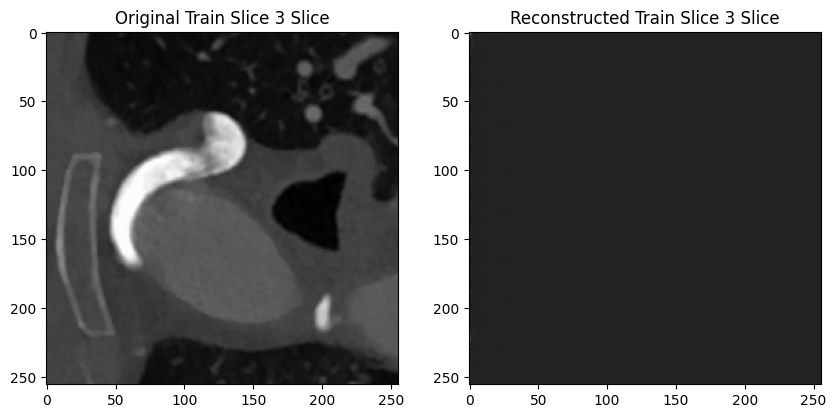

Validation: |          | 0/? [00:00<?, ?it/s]

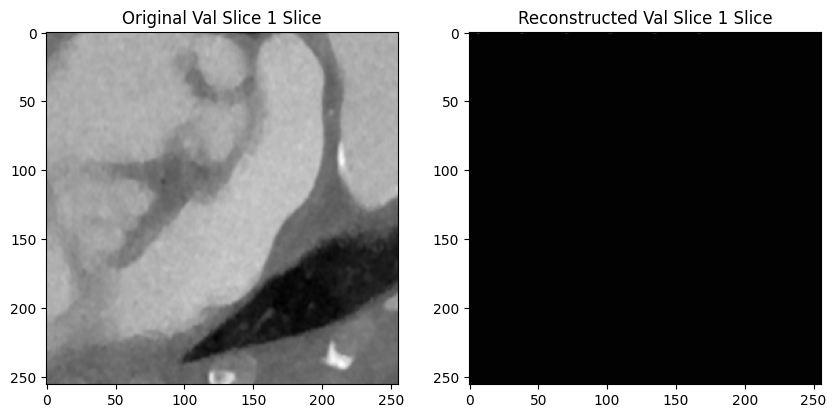

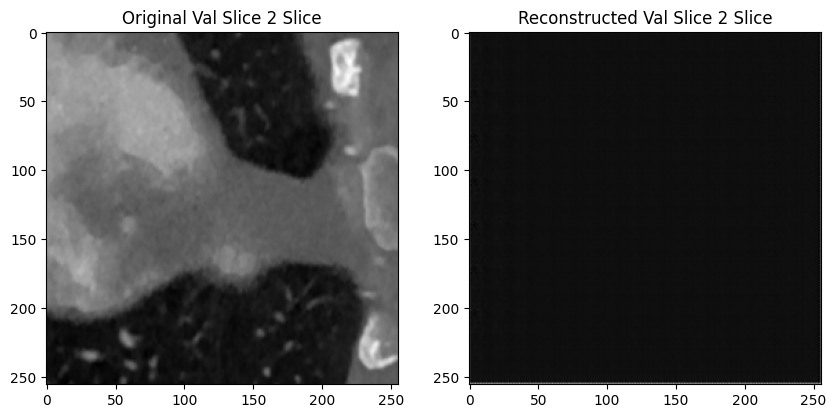

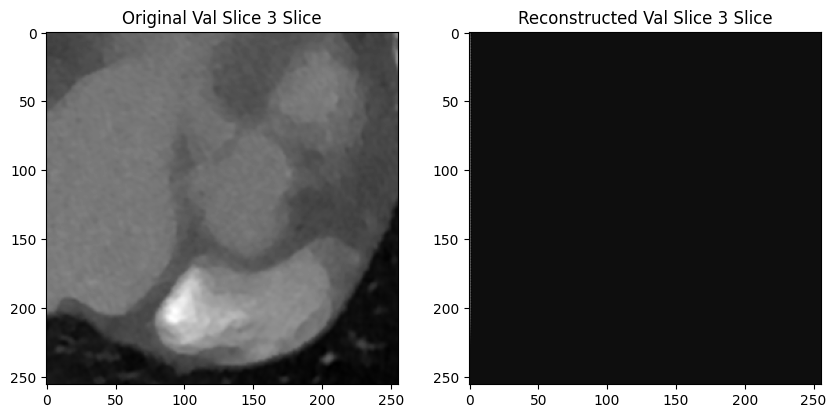

Time Spent 73169.47
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73291.29
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73412.88
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73534.46
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73655.92
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73784.39
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 73905.92
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74027.54
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74150.15
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74276.74
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74401.69
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74525.22
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74646.61
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74768.30
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 74889.57
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75011.03
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75132.52
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75253.75
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75375.13
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75496.61
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75618.17
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75739.72
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75861.26
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 75982.64
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76104.86
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76226.29
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76347.86
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76469.63
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76591.28
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76712.97
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76834.33
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 76955.91
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77089.68
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77211.08
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77332.66
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77454.33
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77575.95
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77697.49
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77818.88
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 77944.21
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78065.72
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78187.18
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78309.49
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78431.17
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78552.75
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78674.31
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78795.78
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 78917.33
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79038.87
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79161.10
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79282.43
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79403.90
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79525.48
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79646.91
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79768.20
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 79889.86
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80011.49
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80133.05
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80254.81
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80376.28
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80497.77
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80619.25
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80740.56
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80861.94
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 80983.40
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81104.71
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81226.59
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81348.05
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81469.49
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81590.78
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81712.24
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81833.68
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 81957.85
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82079.23
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82201.40
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82322.94
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82444.30
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82565.79
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82687.33
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82808.70
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 82930.09
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83051.70
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83173.18
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83295.24
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83416.78
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83538.08
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83659.58
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83786.39
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 83907.91
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84029.41
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84150.77
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84272.21
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84393.58
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84515.34
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84639.36
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84767.01
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 84901.18
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85022.65
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85147.05
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85273.10
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85394.68
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85517.05
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85638.57
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85760.34
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 85882.56
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86004.98
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86126.59
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86250.96
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86385.45
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86506.97
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86628.66
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86752.07
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86873.88
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 86995.13
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87117.42
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87238.98
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87360.37
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87481.77
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87603.13
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87724.53
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87845.93
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 87967.26
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88088.78
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88210.18
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88332.44
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88454.01
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88575.42
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88696.98
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88818.38
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 88939.86
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89061.36
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89183.11
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89304.38
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89425.74
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89547.15
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89668.81
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89790.48
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 89912.12
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90033.49
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90155.06
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90276.48
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90397.83
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90519.20
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90640.49
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90762.04
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 90883.48
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91004.88
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91126.33
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91247.84
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91370.35
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91492.10
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91613.57
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91735.34
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91856.72
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 91978.32
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92100.00
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92221.31
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92342.67
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92464.16
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92585.68
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92706.97
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92828.48
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 92949.78
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93071.12
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93193.76
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93321.87
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93452.12
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93604.49
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93726.09
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93847.42
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 93971.27
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94094.44
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94228.56
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94490.02
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94678.77
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94800.07
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 94921.36
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95061.79
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95183.15
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95304.41
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95425.81
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95547.10
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95668.36
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95790.55
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 95911.89
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96033.14
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96154.54
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96275.93
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96397.54
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96518.83
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96640.07
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96761.32
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 96882.67
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97004.11
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97125.43
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97246.94
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97368.61
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97490.00
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97611.33
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97733.35
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97856.01
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 97977.28
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98098.60
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98219.96
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98341.19
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98462.47
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98583.84
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98705.30
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98826.69
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 98948.10
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99069.39
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99190.76
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99312.12
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99433.43
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99554.72
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99675.90
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99797.34
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 99918.79
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100040.31
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100161.79
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100283.13
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100405.00
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100526.97
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100648.65
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100770.78
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 100892.22
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101013.49
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101134.85
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101256.24
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101377.49
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101498.90
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101620.19
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101741.58
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101863.02
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 101984.28
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102105.62
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102227.21
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102348.66
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102469.97
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102591.89
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102713.16
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102834.41
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 102955.67
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103076.99
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103198.26
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103319.62
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103441.11
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103562.54
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103683.87
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103806.06
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 103927.64
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104048.94
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104170.25
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104291.65
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104412.90
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104534.13
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104655.52
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104776.75
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 104898.11
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105019.38
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105140.63
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105261.91
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105383.35
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105504.81
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105626.32
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105747.79
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105869.22
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 105990.56
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106111.90
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106233.30
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106354.68
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106476.04
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106597.42
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106718.78
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106840.93
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 106962.39
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107083.92
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107205.26
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107326.55
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107447.99
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107569.35
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107690.73
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107812.15
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 107933.63
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108055.16
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108177.26
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108298.69
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108420.10
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108541.49
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108662.83
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108784.30
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 108906.14
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109027.85
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109149.41
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109270.80
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109392.28
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109513.80
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109635.34
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109756.73
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 109879.08
Epoch: 900


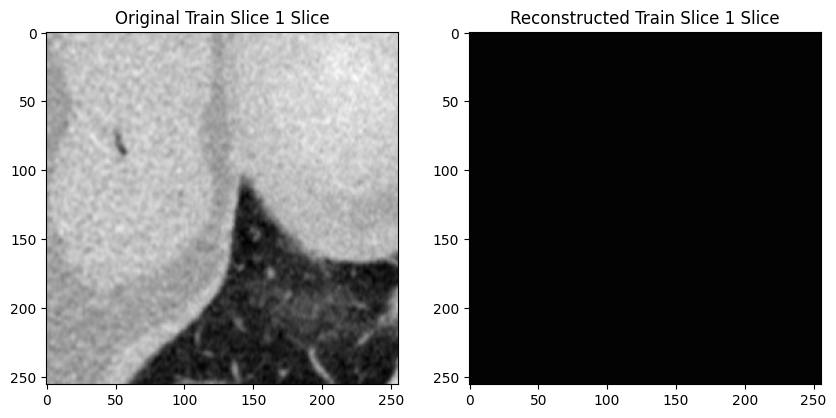

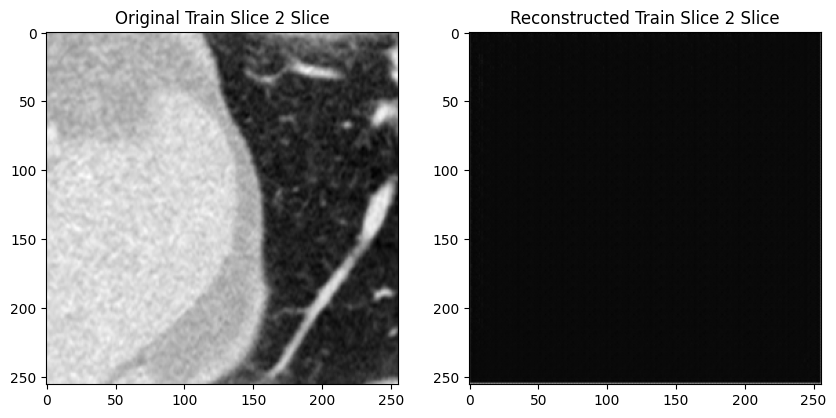

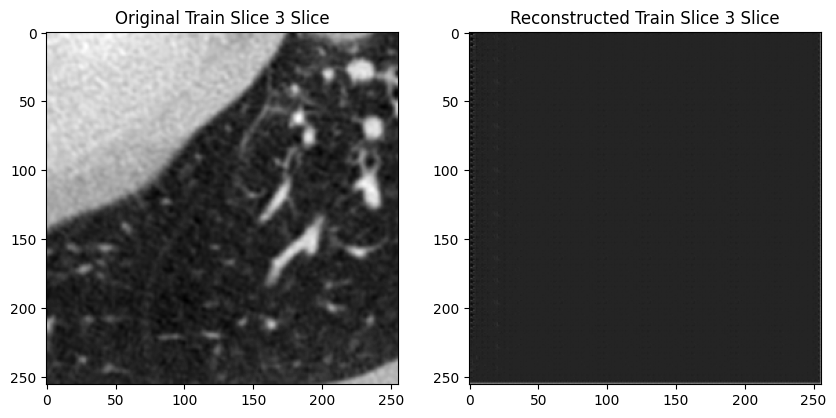

Validation: |          | 0/? [00:00<?, ?it/s]

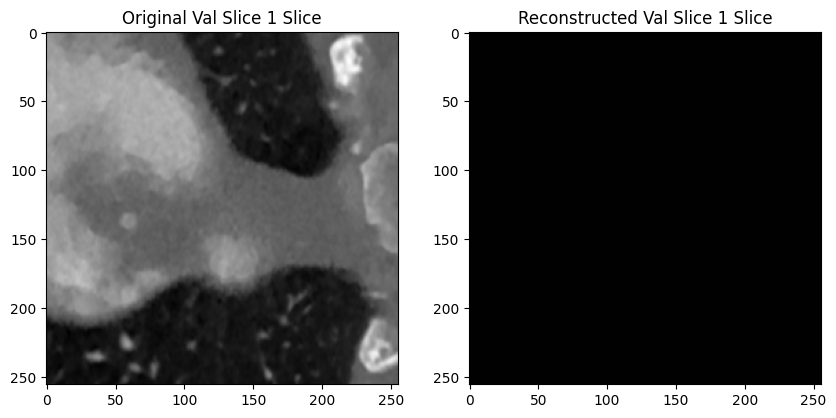

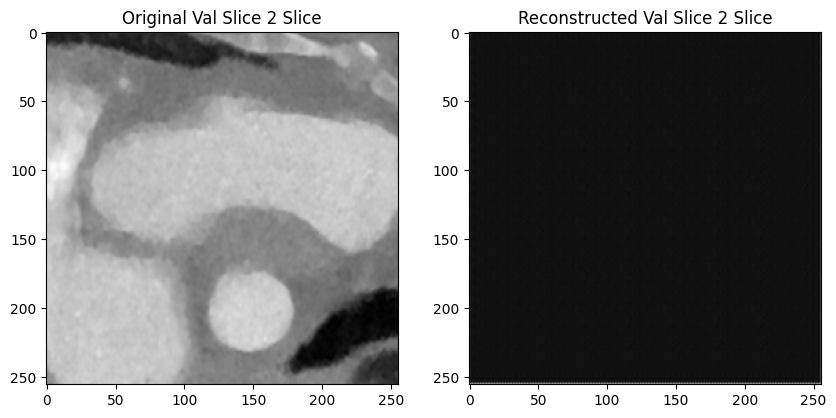

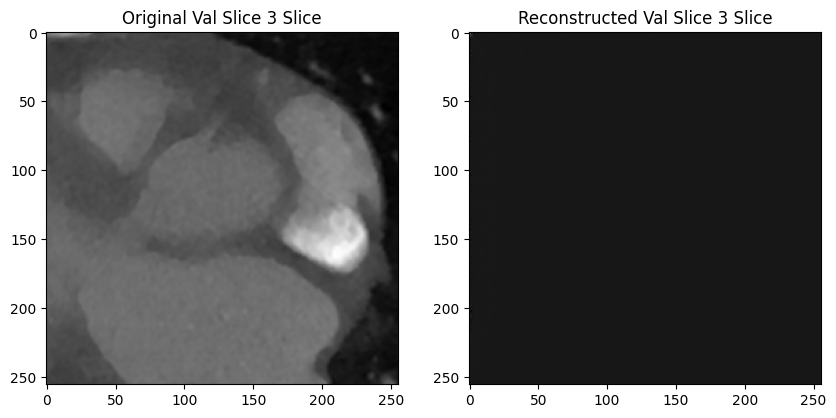

Time Spent 110003.17
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110124.68
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110246.09
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110367.59
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110488.91
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110610.18
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110731.54
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110852.81
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 110974.65
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111095.89
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111217.15
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111338.41
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111459.68
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111580.93
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111702.31
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111823.60
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 111944.92
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112066.23
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112187.49
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112308.83
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112430.06
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112551.41
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112672.67
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112793.96
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 112916.18
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113037.39
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113158.56
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113280.27
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113401.65
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113522.94
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113644.24
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113765.46
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 113886.78
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114008.20
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114129.54
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114250.87
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114372.25
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114493.50
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114614.77
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114736.05
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114857.35
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 114978.67
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115100.00
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115221.41
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115342.63
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115463.86
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115585.19
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115706.51
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115827.83
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 115949.93
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116071.32
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116192.78
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116314.04
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116435.38
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116556.66
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116677.98
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116799.49
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 116920.79
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117042.09
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117163.35
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117284.73
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117406.10
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117527.32
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117648.62
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117770.08
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 117891.54
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118012.84
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118134.14
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118255.51
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118376.81
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118498.10
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118619.59
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118740.91
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118862.31
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 118984.38
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119105.75
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119228.49
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119349.77
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119471.05
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119592.41
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119713.69
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119835.07
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 119956.70
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120078.08
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120199.46
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120320.80
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120442.18
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120563.59
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120684.91
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120806.23
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 120927.80
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121049.18
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121170.42
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121291.87
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121413.26
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121534.61
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121655.99
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121777.31
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 121898.85
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122020.97
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122143.28
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122264.69
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122386.33
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122507.73
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122629.18
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122750.93
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122872.35
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 122993.61
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123115.02
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123236.37
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123357.93
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123479.21
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123600.70
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123722.11
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123843.40
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 123964.78
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124086.08
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124207.44
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124328.71
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124450.02
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124571.26
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124692.57
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124813.90
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 124935.32
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125057.66
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125178.98
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125300.25
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125421.63
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125543.12
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125664.45
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125785.78
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 125907.15
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126028.59
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126150.03
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126271.50
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126392.88
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126514.24
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126635.64
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126757.03
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126878.37
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 126999.60
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127120.87
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127242.27
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127363.59
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127484.83
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127606.17
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127727.54
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127848.84
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 127970.29
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128092.36
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128213.64
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128334.96
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128456.36
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128577.67
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128699.02
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128820.43
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 128941.68
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129063.15
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129184.58
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129306.01
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129427.48
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129548.85
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129670.25
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129791.70
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 129914.13
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130035.43
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130156.77
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130278.01
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130399.34
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130520.68
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130642.09
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130763.42
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 130884.90
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131006.35
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131128.65
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131250.06
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131371.38
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131492.90
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131614.30
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131735.65
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131856.97
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 131978.27
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132099.53
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132221.12
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132342.68
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132464.11
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132585.49
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132706.92
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132828.38
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 132949.82
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133071.27
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133192.74
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133314.09
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133435.42
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133556.80
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133678.69
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133800.17
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 133921.74
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134043.31
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134165.45
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134286.67
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134407.98
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134529.37
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134650.91
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134772.35
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 134893.86
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135015.33
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135136.98
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135258.43
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135379.83
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135501.21
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135622.59
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135743.94
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135865.40
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 135986.85
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136108.25
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136229.72
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136351.18
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136472.72
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136594.13
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136715.50
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136836.88
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 136958.37
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137079.66
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137201.79
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137323.59
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137445.11
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137566.53
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137687.95
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137809.40
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 137931.01
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138052.50
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138173.95
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138295.23
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138416.52
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138537.91
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138659.36
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138780.67
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 138902.01
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139023.32
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139144.63
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139267.13
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139388.71
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139510.08
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139631.57
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139752.90
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139874.16
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 139995.77
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140117.01
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140239.09
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140360.37
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140481.71
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140603.04
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140724.47
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140845.86
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 140967.30
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141088.72
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141210.08
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141331.52
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141452.80
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141574.19
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141695.69
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141817.35
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 141938.68
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142060.07
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142181.52
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142302.97
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142424.44
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142545.82
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142667.28
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142788.73
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 142910.11
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143031.48
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143152.81
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143274.91
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143396.28
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143517.72
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143639.32
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143760.75
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 143882.37
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144003.83
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144125.23
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144246.71
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144368.26
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144489.93
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144611.52
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144732.87
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144854.34
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 144975.84
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145097.21
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145218.61
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145340.09
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145461.71
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145583.02
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145704.53
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145825.88
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 145947.25
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146068.70
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146190.19
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146312.30
Epoch: 1200


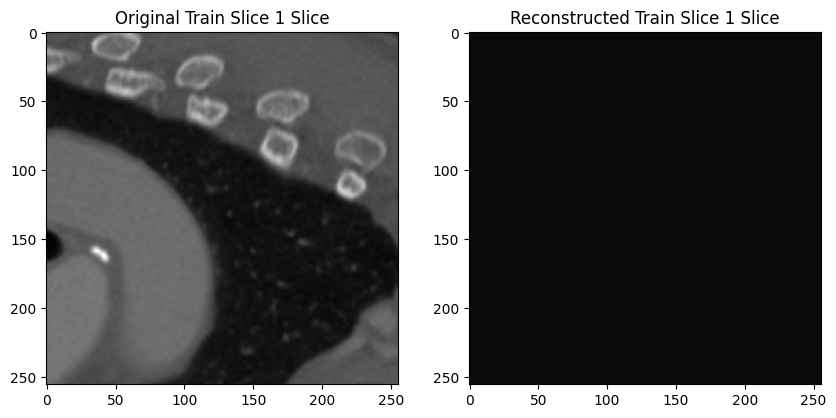

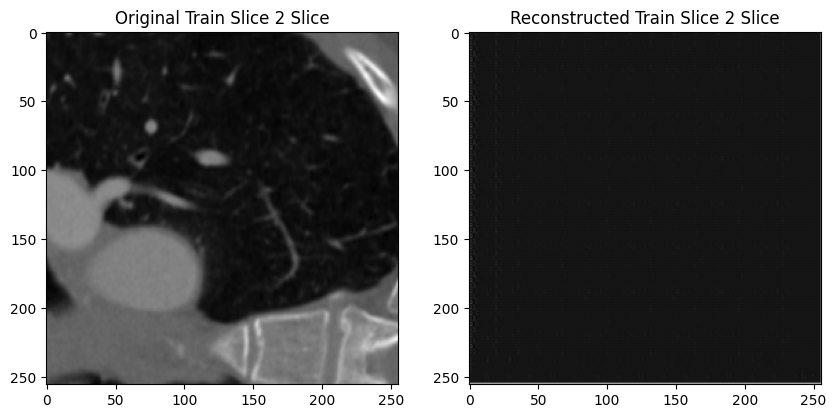

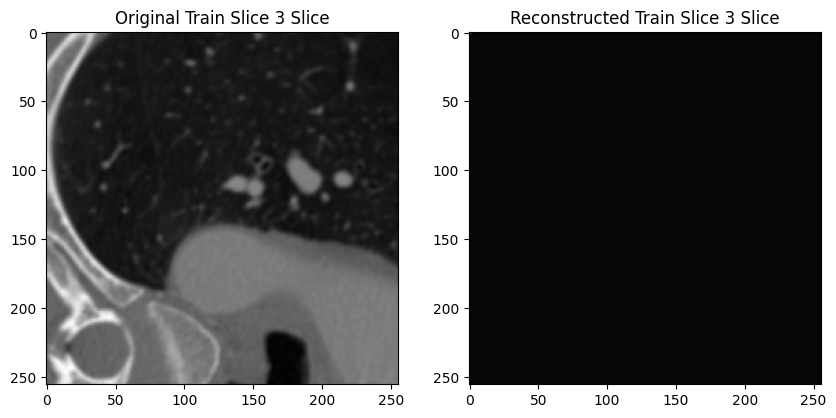

Validation: |          | 0/? [00:00<?, ?it/s]

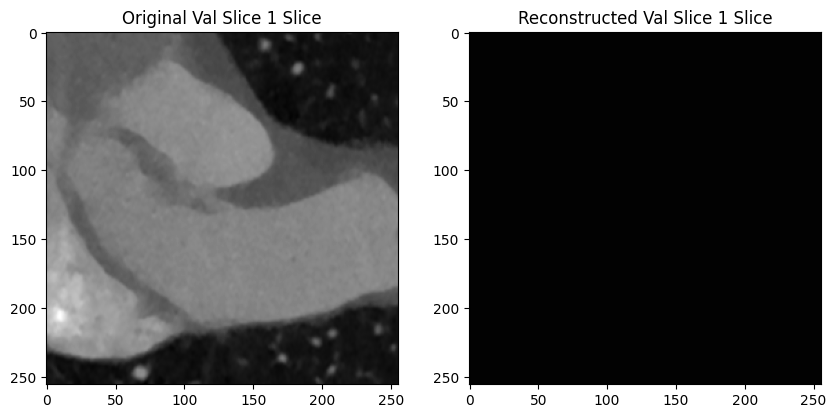

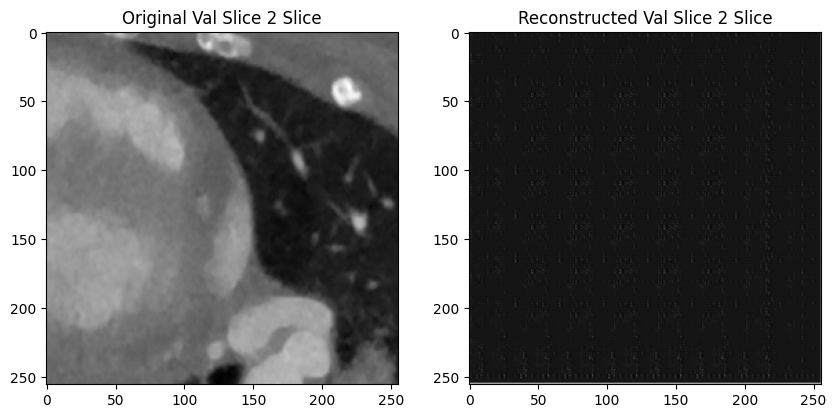

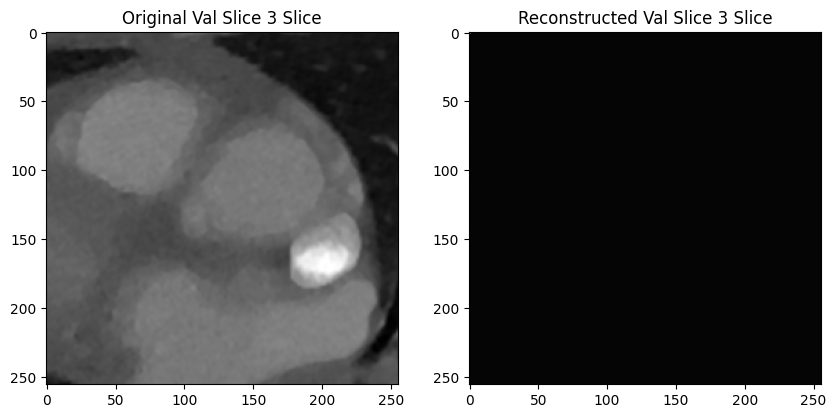

Time Spent 146436.96
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146558.39
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146680.29
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146801.70
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 146923.00
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147044.32
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147165.73
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147287.16
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147408.72
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147530.26
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147651.74
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147773.20
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 147894.75
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148016.21
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148137.64
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148259.14
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148380.74
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148502.39
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148624.03
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148745.54
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148867.12
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 148988.69
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149110.12
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149231.61
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149353.70
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149475.07
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149596.51
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149717.94
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149839.51
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 149961.05
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150082.43
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150203.73
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150325.32
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150446.94
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150568.24
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150690.04
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150812.33
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150933.65
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151054.97
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151176.25
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151297.60
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151418.87
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151540.24
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151661.56
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151782.98
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 151904.26
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152025.61
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152146.91
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152268.46
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152390.56
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152511.86
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152633.21
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152754.47
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152875.74
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 152997.02
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153118.41
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153239.64
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153360.91
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153482.19
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153603.47
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153724.89
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153846.39
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 153967.85
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154089.14
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154210.43
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154331.72
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154452.94
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154574.19
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154695.48
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154816.73
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 154938.11
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155059.42
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155180.84
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155302.15
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155424.28
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155545.65
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155667.85
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155789.57
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 155910.97
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156032.34
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156153.76
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156275.18
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156396.58
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156518.02
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156639.56
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156760.98
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 156882.47
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157003.81
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157125.18
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157246.52
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157368.04
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157490.75
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157612.13
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157733.53
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157855.16
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157976.64
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158097.98
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158219.34
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158340.67
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158463.00
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158584.55
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158705.98
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158834.05
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 158955.46
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159076.90
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159198.36
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159319.63
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159440.94
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159562.23
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159683.57
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159804.94
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159926.28
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160047.64
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160168.96
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160290.38
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160411.70
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160533.00
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160654.28
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160775.54
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 160896.89
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161018.27
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161139.57
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161260.86
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161382.03
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161504.08
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161625.65
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161746.88
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161868.30
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 161989.60
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162110.89
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162232.22
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162353.50
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162474.87
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162596.16
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162717.56
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162839.19
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 162960.90
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163082.16
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163203.63
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163324.99
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163446.23
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163567.50
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163688.80
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163810.16
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 163933.04
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164054.33
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164175.59
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164297.65
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164418.94
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164540.96
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164662.25
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164783.76
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 164905.59
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165026.84
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165148.14
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165269.60
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165390.84
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165512.24
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165633.57
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165754.82
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165876.09
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 165997.55
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166119.21
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166240.52
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166361.77
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166483.06
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166604.46
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166725.68
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166846.99
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 166968.51
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167089.83
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167211.52
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167332.79
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167454.09
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167576.20
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167697.69
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167819.04
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167940.35
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168061.65
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168183.06
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168304.45
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168425.85
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168547.04
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168668.44
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168789.69
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 168911.01
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169032.63
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169154.37
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169275.79
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169397.31
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169518.65
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169640.05
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169761.45
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169882.93
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170004.38
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170125.93
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170247.30
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170368.81
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170490.18
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170612.41
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170734.78
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170856.13
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 170977.65
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171099.11
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171220.62
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171341.97
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171463.41
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171584.89
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171707.24
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171828.72
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 171950.30
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172071.91
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172193.18
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172314.70
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172436.08
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172557.62
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172679.06
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172800.55
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 172923.88
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173045.76
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173167.21
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173288.55
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173409.98
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173531.54
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173653.82
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173775.20
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 173896.52
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174018.01
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174139.46
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174260.76
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174382.05
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174503.45
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174624.92
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174746.24
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174867.57
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 174988.87
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175110.26
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175231.58
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175352.82
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175474.09
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175595.37
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175716.55
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175837.94
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 175959.26
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176080.83
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176202.11
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176323.34
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176444.61
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176565.94
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176687.91
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176809.16
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176930.41
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177051.79
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177173.22
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177294.72
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177416.19
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177537.38
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177659.45
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177780.76
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 177902.16
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178023.62
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178145.01
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178266.46
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178388.30
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178509.98
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178631.25
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178752.54
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178873.94
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 178995.28
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179116.58
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179237.86
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179359.33
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179480.75
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179602.08
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179724.08
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179845.47
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 179966.87
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180088.16
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180209.60
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180331.04
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180452.26
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180710.07
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180831.36
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 180952.67
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181074.08
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181195.53
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181317.07
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181438.43
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181559.71
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181681.00
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181802.30
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181923.75
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182045.04
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182166.33
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182287.60
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182408.85
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182530.02
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182651.46
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182772.82
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 182895.05
Epoch: 1500


`Trainer.fit` stopped: `max_epochs=1500` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1386133      

In [3]:
# Initialize model and start training
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')